In [227]:
import numpy as np
import time, os, sys
from urllib.parse import urlparse
import matplotlib.pyplot as plt
import matplotlib as mpl
#%matplotlib inline
from skimage import exposure
mpl.rcParams['figure.dpi'] = 300
from cellpose import utils, io, plot, models
from scipy.ndimage import binary_erosion, binary_fill_holes
import subprocess
import os
import pandas as pd

In [ ]:
script = f'POSIX path of (choose file of type {{"public.tiff"}} default location "{current_directory}")'
selected_file = subprocess.check_output(['osascript', '-e', script]).decode('utf-8').strip()

In [228]:
# Get the current working directory
current_directory = os.getcwd()


script = f'POSIX path of (choose file of type {{"public.tiff"}} default location "{current_directory}")'
selected_file = subprocess.check_output(['osascript', '-e', script]).decode('utf-8').strip()

#print("Selected file:", selected_file)


img = io.imread(selected_file)
#plt.figure(figsize=(2,2))
plt.figure()
plt.text(200,200, 'Hello') #proof of concept I can put text over images in the right spot
plt.imshow(img)
plt.axis('off')
plt.show()

# I can run a custom model 

#model = models.Cellpose(gpu=False, model_type='cyto2')
model = models.CellposeModel(model_type='T5_V1')
masks, flows, styles = model.eval(img, diameter=None, channels=[0,0])

fig = plt.figure(figsize=(8,2.5))
plot.show_segmentation(fig, img, masks, flows[0], channels=[0,0])
plt.tight_layout()
plt.show()

KeyboardInterrupt: 

In [ ]:
print('Number of ROIs:', max(np.unique(masks)))

Number of ROIs: 33


In [ ]:
new_mask_23 = (masks == 23).astype(int)
np.sum(img[masks == 23]/np.sum(new_mask_23))

37.17546848381602

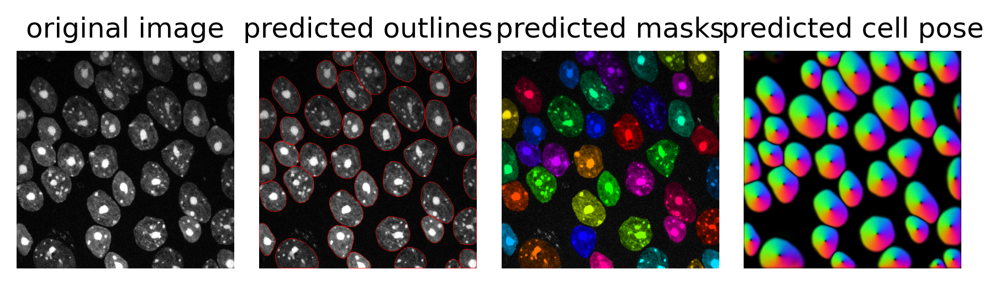

In [ ]:
from cellpose import plot, models, io

model = models.Cellpose(gpu=False, model_type='cyto')
masks, flows, styles, diams = model.eval(img, diameter=None, channels=[0,0])


fig = plt.figure(figsize=(8,2.5))
plot.show_segmentation(fig, img, masks, flows[0], channels=[0,0])
plt.tight_layout()
plt.show()

In [ ]:
io.save_rois(masks, '/Users/raphaeltinio/LabAnalysis/ImageAnalysis/20230712_ctrl_Tusc5_488_WGA_568_Glut1_647_DAPI_100x_3.nd2/roi')

# Ability to plot overlay

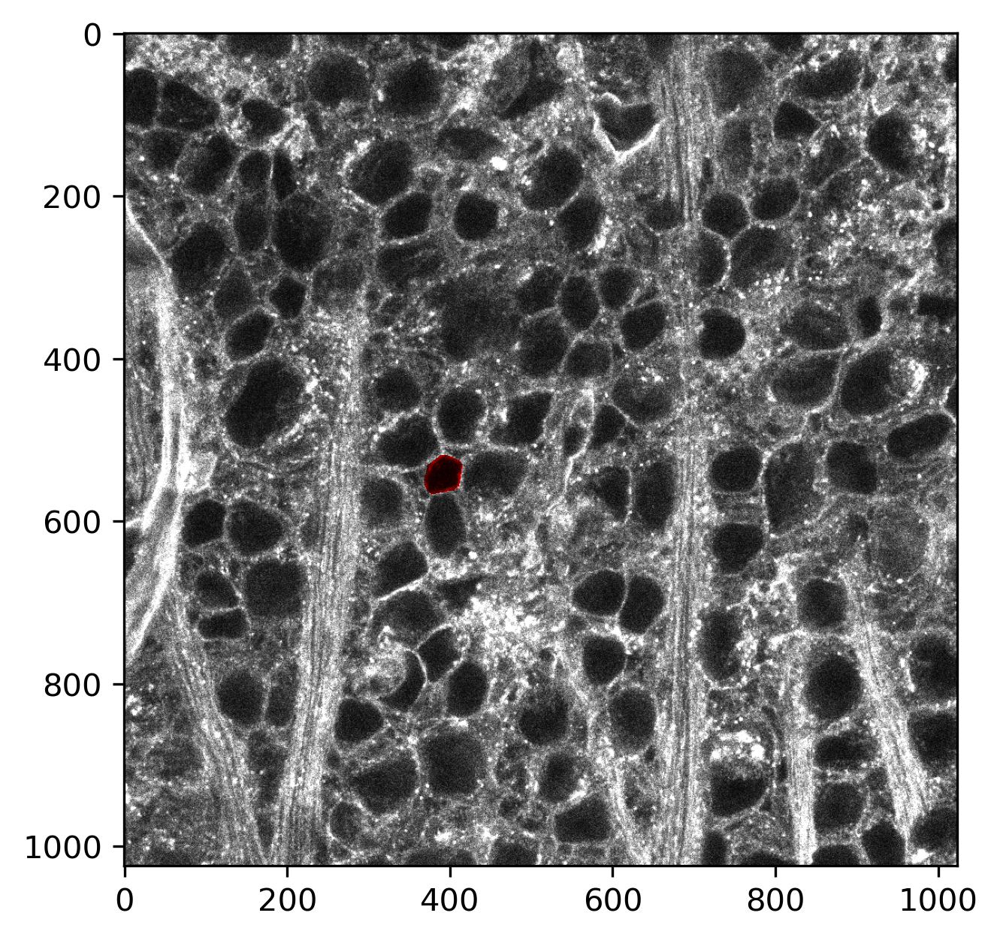

In [ ]:
# Overlay
overlay = plot.mask_overlay(img, new_mask_23)
plt.imshow(overlay)

In [ ]:
np.array([0,1,0,1,0,1])[np.array([True,False,False,True,False,False])] #You can index numpy arrays by 

array([0, 1])

# Attemping to get fluoresence of a single cell

In [ ]:
img_path = '/Users/raphaeltinio/Desktop/test stacks/new_2007R_DAPI_proj1.tif'
image = io.imread(img_path)


segpy_path = '/Users/raphaeltinio/Desktop/test stacks/2007R_DAPI_proj1_seg.npy'
dat = np.load(segpy_path, allow_pickle=True).item()

FileNotFoundError: [Errno 2] No such file or directory: '/Users/raphaeltinio/Desktop/test stacks/new_2007R_DAPI_proj1.tif'

In [ ]:
pixel_value = np.sum(image[dat['masks'].astype(bool)])

print('Summed pixel value:', pixel_value)

NameError: name 'image' is not defined

In [ ]:
overlay = plot.mask_overlay(image.astype('int'), dat['masks'])
plt.imshow(overlay)
plt.axis('off')

NameError: name 'image' is not defined

# Image Soma Centering

In [ ]:
img_path = '/Users/raphaeltinio/Desktop/test stacks/2007R_GLUT1_647_WGA_594_0002.tif'
image = io.imread(img_path)

#Halfway point of each image
middle_slice = int(image.shape[0]/2)
image.shape

100%|██████████| 408/408 [00:00<00:00, 1433.30it/s]


(102, 4, 1024, 1024)

In [ ]:
'''
Compresses the brightest pixels from the entire stack into one slice
'''

def max_proj(channel_zstack):
    channel_max = np.max(channel_zstack, axis = 0)
    return channel_max

'''
Applies "auto" from bright and contrast plug-in from FIJI
Does not follow the same algorithmn
'''
def auto_brightness_contrast(image):
    # Convert to float and normalize to range [0, 1]
    normalized_image = image.astype(np.float32) / 255.0
    equalized_image = exposure.equalize_adapthist(normalized_image)
    equalized_image = (equalized_image * 255).astype(np.uint8)
    
    return equalized_image

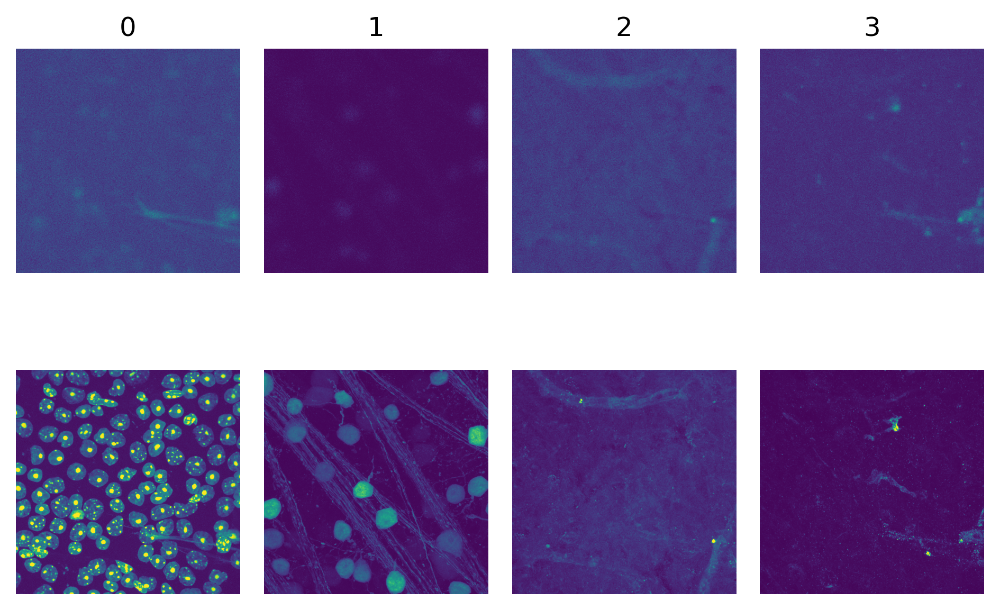

In [ ]:
fig, axs = plt.subplots(2, 4)

for channel in range(image.shape[1]):
    axs[0, channel].imshow(image[int(image.shape[1]/2), channel])
    axs[0, channel].axis('off')
    axs[0, channel].set_title(channel)
    
    axs[1, channel].imshow(max_proj(image[:, channel, :, :]))
    axs[1, channel].axis('off')

plt.tight_layout()



In [ ]:
segpy_path = '/Users/raphaeltinio/Desktop/test stacks/MAX_2007R_GLUT1_647_WGA_594_0002.tif #1_seg.npy'
dat = np.load(segpy_path, allow_pickle=True).item()

(-0.5, 1023.5, 1023.5, -0.5)

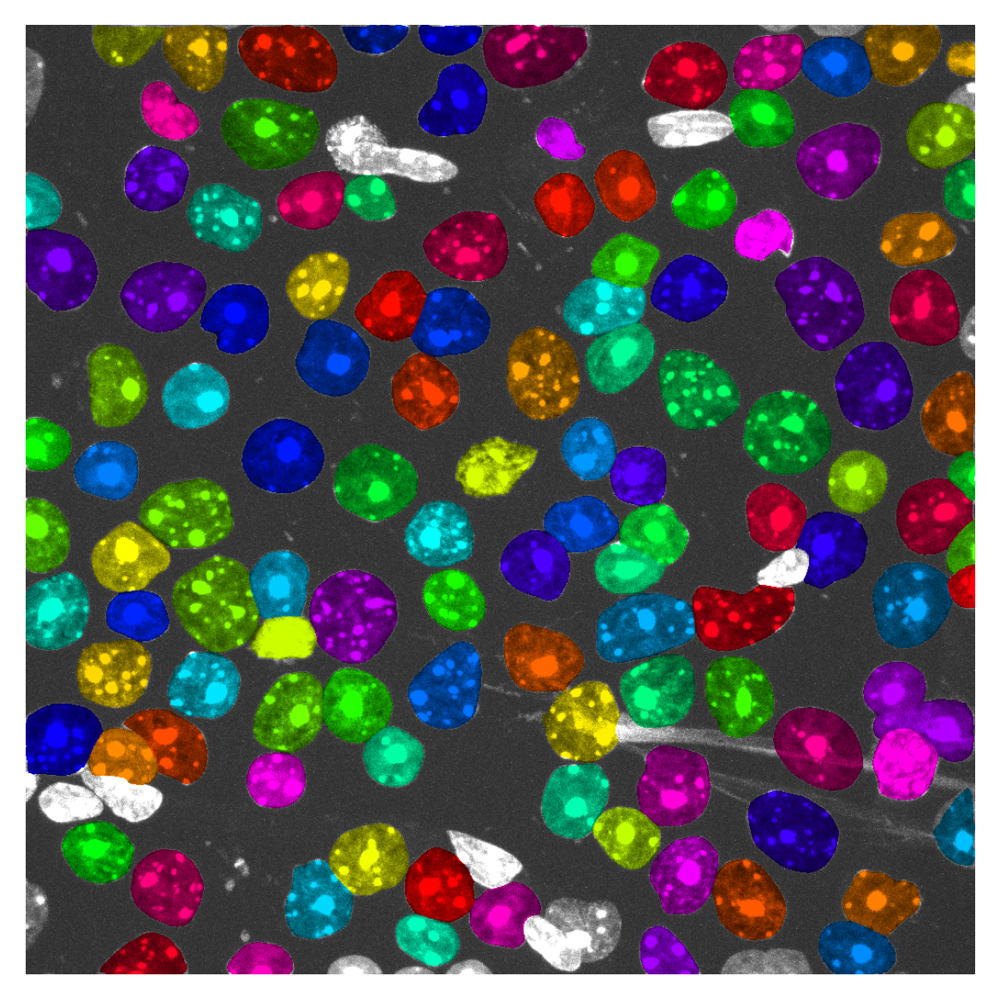

In [ ]:
overlay = plot.mask_overlay(max_proj(image[:, 0]), dat['masks'])
plt.imshow(overlay)
plt.axis('off')

In [ ]:
'''
Returning z indicies where the nuclei of each roi has the greatest intensity
'''

def nuclei_slices(single_channel, masks):

    total_masks = np.delete(np.unique(masks,0),0)
    number_slices = single_channel.shape[0]
    
    max_z_slices = []

    for mask in total_masks:
        single_mask = masks == mask
        
        intensity_max = 0
        intensity_max_slice = 0

        for slice in range(number_slices):
            layer_intensity = np.sum(image[slice,0][single_mask])

            if layer_intensity > intensity_max:
                intensity_max = layer_intensity
                intensity_max_slice = slice

        max_z_slices.append(intensity_max_slice)

    return max_z_slices

total_nuclei_slices = nuclei_slices(image[:,0,:,:], dat['masks'])

In [ ]:
'''
Somehow this code below is slower than the one above. They do the same thing
'''

def nuclei_slices_exp(single_channel, masks):

    total_masks = np.delete(np.unique(masks,0),0)
    
    max_z_slices = []

    for mask in total_masks:
        single_mask = masks == mask

        masked_channel = single_channel * single_mask

        z_prof = np.sum(masked_channel, axis = (1,2))
        
        z_max_idx = np.argmax(z_prof)

        max_z_slices.append(z_max_idx)

    return max_z_slices

total_nuclei_slices_exp = nuclei_slices_exp(image[:,0,:,:], dat['masks'])

In [ ]:
def cell_projector(single_channel, masks, nuclei_z_indicies):
    # temp_image = single_channel.copy()
    

    max_average = int(np.sum(total_nuclei_slices)/len(total_nuclei_slices))
    edited_image = single_channel[max_average].copy()
    base_image_display = single_channel[max_average].copy()
    total_masks = np.delete(np.unique(masks,0),0)

    # Editing each roi so we are centered at the middle of each soma

    for mask in total_masks:
        single_mask = dat['masks'] == mask
        single_slice = nuclei_z_indicies[mask-1]

        edited_image[single_mask] = single_channel[single_slice][single_mask]

    return base_image_display, edited_image

base_image_display, edited_image = cell_projector(image[:,0,:,:], dat['masks'], total_nuclei_slices)

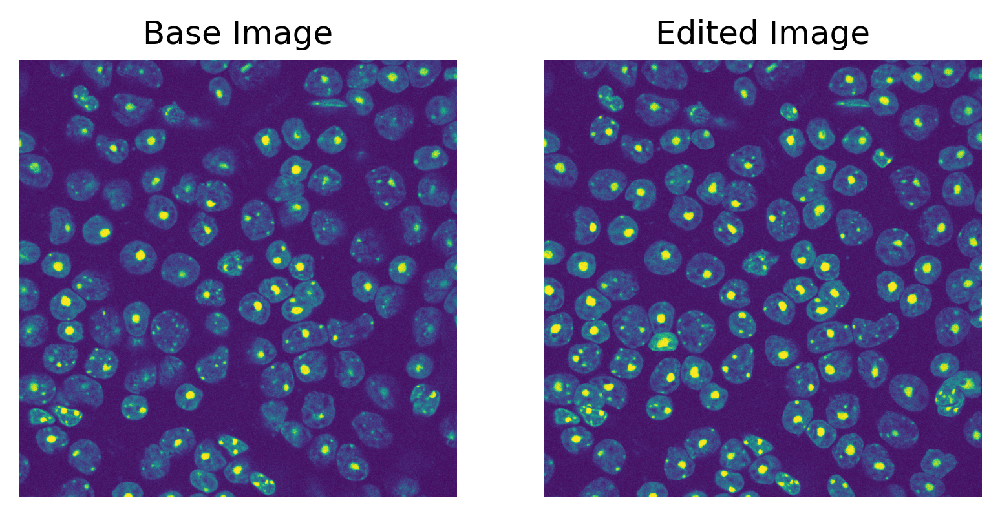

In [ ]:
def plot_before_after(before_image, after_image, auto_bc = False):

    if auto_bc == True:
        before_image = auto_brightness_contrast(before_image)
        after_image = auto_brightness_contrast(after_image)

    fig, axs = plt.subplots(1,2)

    axs[0].imshow(before_image)
    axs[0].axis('off')
    axs[0].set_title('Base Image')

    axs[1].imshow(after_image)
    axs[1].axis('off')
    axs[1].set_title('Edited Image')


plot_before_after(base_image_display, edited_image, auto_bc = False)


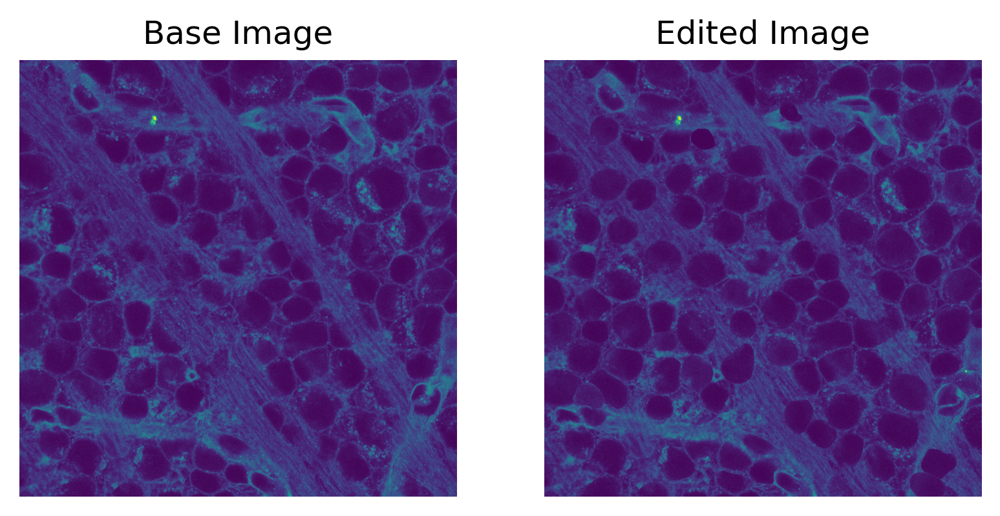

In [ ]:
WGA_base, WGA_projected = cell_projector(image[:,2,:,:], dat['masks'], total_nuclei_slices)

plot_before_after(WGA_base, WGA_projected, auto_bc = True)

In [ ]:
model = models.Cellpose(gpu=False, model_type='cyto3')
masks, flows, styles, diams = model.eval(WGA_projected, diameter=None, channels=[0,0])

In [ ]:
import nd2

img_path = '/Users/raphaeltinio/Desktop/test stacks/2007R_GLUT1_647_WGA_594_0002.nd2'

f = nd2.ND2File(img_path)

In [ ]:
# We can get slice seperation from this. Units in microns
f.voxel_size()

VoxelSize(x=0.1230136717283775, y=0.1230136717283775, z=0.15)

In [ ]:
# Dimensions of image
print(f'{round(f.voxel_size().x, 2)} micron per pixel in x')
print(f'{round(f.voxel_size().y, 2)} micron per pixel in y')
print(f'{f.voxel_size().z} micron slice seperation')
print(f'{round(f.voxel_size().x * f.shape[-2],2)} microns by {round(f.voxel_size().y * f.shape[-1],2)} microns')

print(f'Image shape: {f.shape}')

0.12 micron per pixel in x
0.12 micron per pixel in y
0.15 micron slice seperation
125.97 microns by 125.97 microns
Image shape: (102, 4, 1024, 1024)


In [ ]:
image = f.asarray()

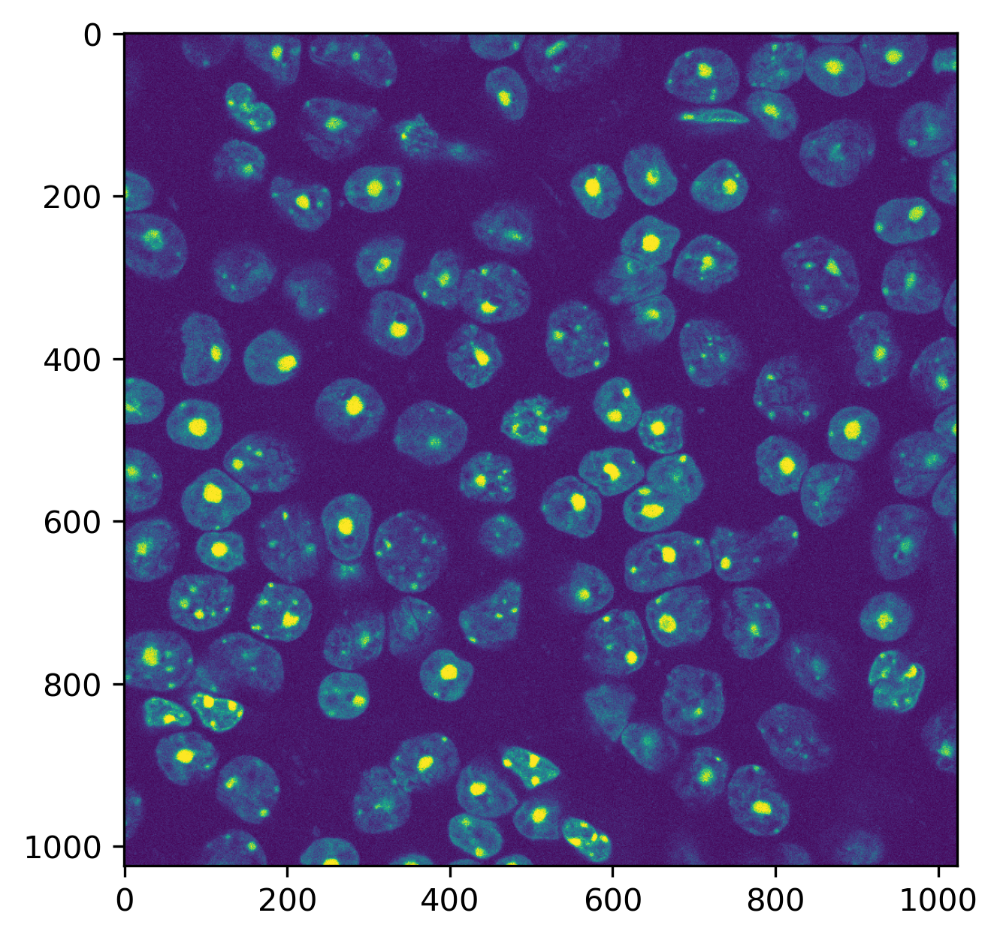

In [ ]:
def to_8bit(image, do_scaling=True):
    if image.dtype != np.uint16:
        raise ValueError("Input image must be of dtype np.uint16")
    
    output_image = np.zeros(image.shape, dtype=np.uint8)
    
    if do_scaling:
        min_val = image.min()
        max_val = image.max()
        scale = 256.0 / (max_val - min_val + 1)
        output_image = ((image - min_val) * scale).clip(0, 255).astype(np.uint8)
    else:
        output_image = image.clip(0, 255).astype(np.uint8)
    
    return output_image


plt.imshow(to_8bit(f.asarray()[36,0]))


# WaterShed

In [ ]:
DAPI_stack = to_8bit(image[:,0,:,:].copy())
WGA_stack = to_8bit(image[:,2,:,:].copy())

In [ ]:
mp_DAPI = max_proj(DAPI_stack)

model = models.CellposeModel(model_type='T5_DAPI_V1')
masks, flows, styles = model.eval(mp_DAPI, diameter=None, channels=[0,0])

(-0.5, 1023.5, 1023.5, -0.5)

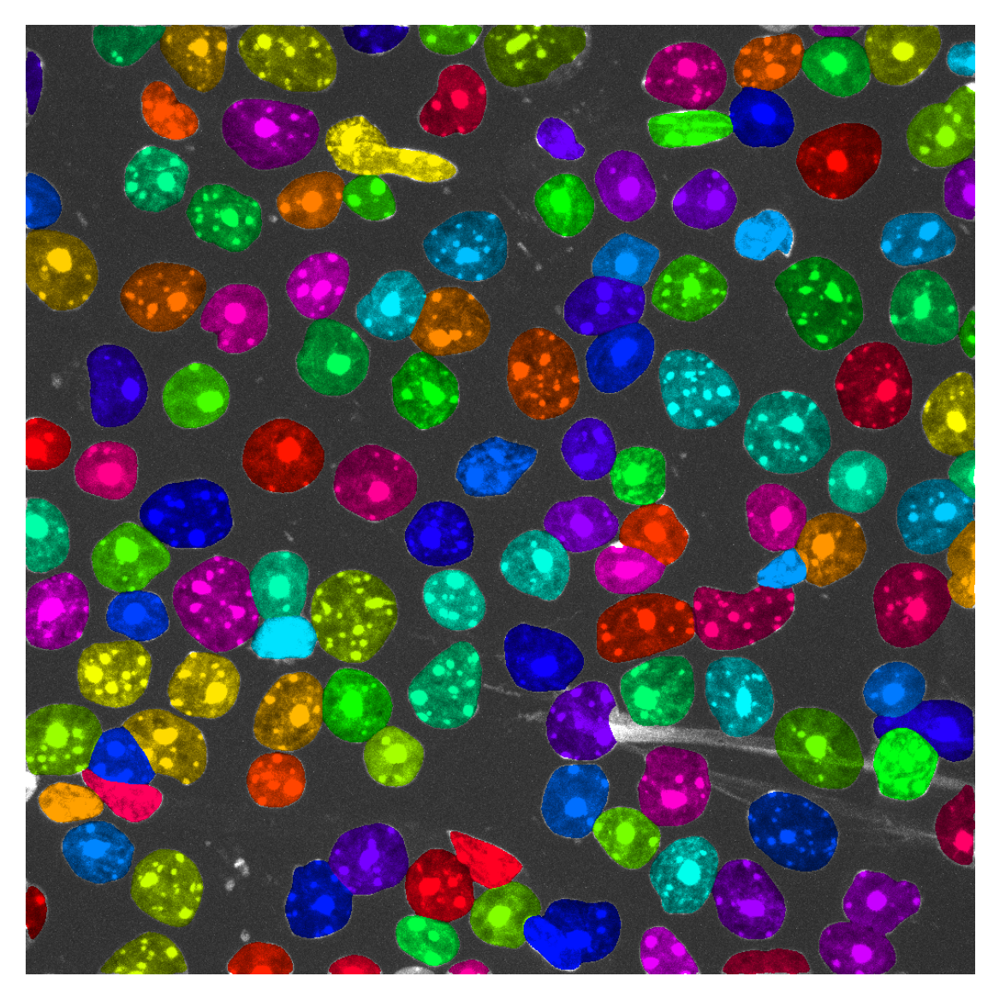

In [ ]:
mp_DAPI = max_proj(DAPI_stack)

overlay = plot.mask_overlay(mp_DAPI, masks)
plt.imshow(overlay)
plt.axis('off')

(-0.5, 1023.5, 1023.5, -0.5)

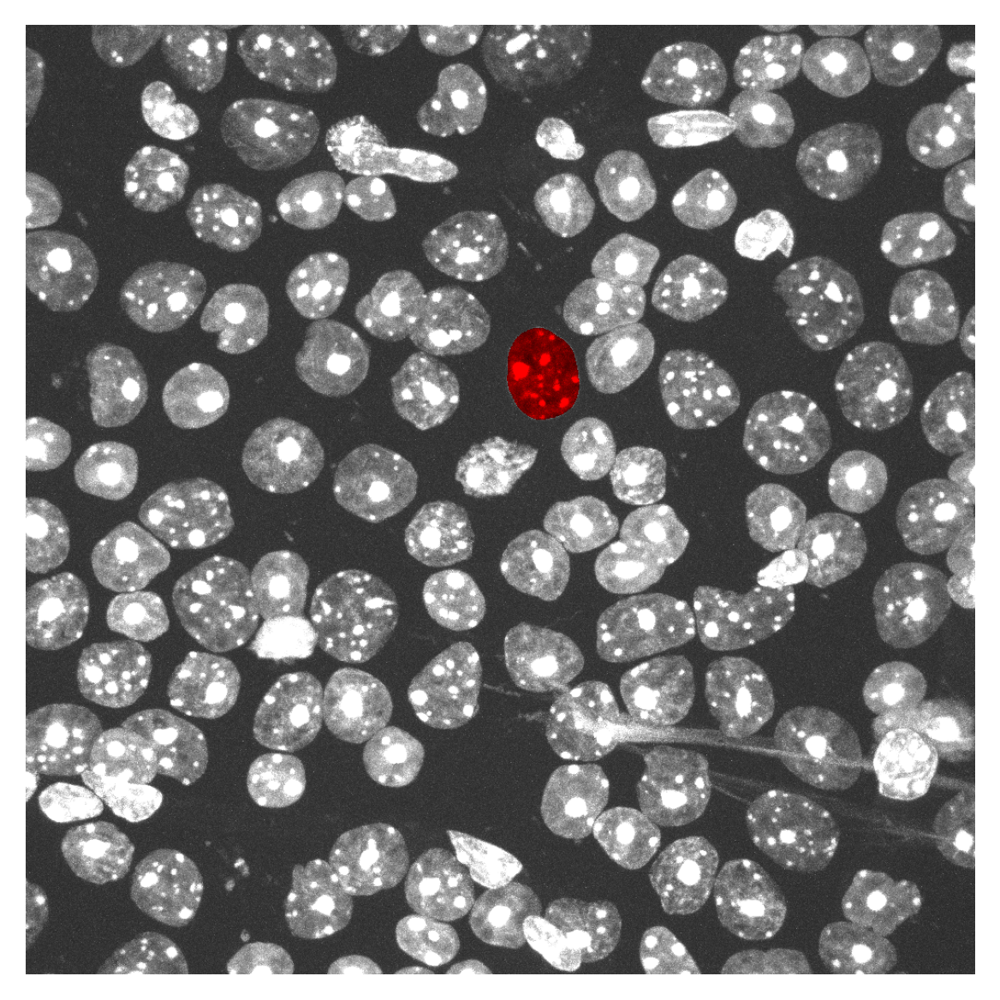

In [ ]:
single_mask = masks.copy() == 49
plt.imshow(plot.mask_overlay(mp_DAPI, single_mask.astype(int)))
plt.axis('off')

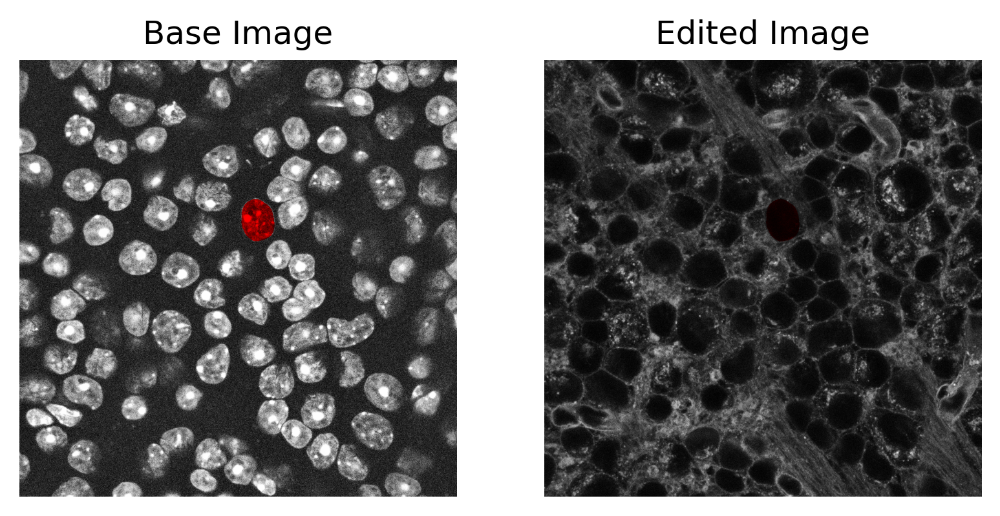

In [ ]:
z_oi = nuclei_slices(DAPI_stack, single_mask)

plot_before_after(plot.mask_overlay(DAPI_stack[z_oi[0],:,:], single_mask.astype(int)),
                  plot.mask_overlay(WGA_stack[z_oi[0],:,:], single_mask.astype(int)),
                  auto_bc = True)

In [ ]:
import numpy as np
from scipy.ndimage import measurements

def nuclei_centers_of_mass(single_channel, masks):
    """
    Returns the (x, y, z) coordinates of the center of mass for each mask.

    :param single_channel: 3D numpy array (slices, height, width) of a single channel.
    :param masks: 3D numpy array (same shape as single_channel) with mask labels.
    :return: List of tuples containing (x, y, z) coordinates of the center of mass.
    """
    total_masks = np.delete(np.unique(masks,0),0)
    
    centers_of_mass = []

    for mask in total_masks:
        single_mask = masks == mask

        masked_channel = single_channel * single_mask

        z_prof = np.sum(masked_channel, axis = (1,2))
        
        z_max_idx = np.argmax(z_prof)

        # Calculate the center of mass for the mask
        center_of_mass = measurements.center_of_mass(single_mask)
        
        # The z coordinate of the center of mass is determined by the slice with the max intensity
        center_of_mass_3d = (int(center_of_mass[0]), int(center_of_mass[1]), z_max_idx)

        centers_of_mass.append(center_of_mass_3d)

    return centers_of_mass

# Example usage:
# Assuming 'image' is a 4D numpy array with shape (slices, channels, height, width)
# and 'masks' is a 3D numpy array with shape (slices, height, width)
centers_of_mass = nuclei_centers_of_mass(image[:,0,:,:], dat['masks'])
print(centers_of_mass)


/var/folders/sl/syqsj8q94yn7kbv8l50mtwdw0000gn/T/ipykernel_40066/3849315746.py:26: DeprecationWarning: Please use `center_of_mass` from the `scipy.ndimage` namespace, the `scipy.ndimage.measurements` namespace is deprecated.
  center_of_mass = measurements.center_of_mass(single_mask)


[(19, 106, 46), (31, 184, 37), (34, 284, 29), (13, 376, 48), (14, 456, 40), (30, 545, 40), (28, 943, 37), (39, 801, 32), (44, 874, 41), (54, 712, 34), (36, 1009, 39), (83, 463, 38), (94, 152, 36), (100, 793, 44), (115, 262, 42), (123, 574, 95), (145, 876, 32), (166, 140, 45), (172, 646, 35), (177, 1008, 44), (189, 732, 40), (188, 308, 39), (191, 16, 40), (193, 581, 40), (186, 370, 93), (207, 214, 38), (226, 795, 55), (238, 477, 44), (230, 960, 35), (262, 36, 41), (254, 646, 38), (280, 315, 26), (284, 715, 32), (298, 857, 38), (291, 147, 44), (303, 395, 31), (306, 968, 32), (303, 621, 43), (315, 227, 46), (321, 458, 40), (359, 330, 42), (358, 640, 44), (376, 556, 43), (389, 914, 32), (388, 96, 32), (393, 722, 32), (395, 430, 32), (400, 182, 42), (420, 997, 31), (440, 820, 27), (452, 21, 33), (456, 607, 41), (465, 276, 42), (476, 504, 34), (480, 87, 34), (493, 376, 42), (486, 661, 43), (491, 896, 34), (484, 1011, 33), (527, 174, 33), (528, 977, 31), (530, 808, 33), (537, 599, 38), (550, 

In [ ]:
def remove_outliers(data):
    """
    Remove numbers from the list that have a standard deviation greater than 1 from the mean.

    :param data: List of numbers.
    :return: List of numbers with outliers removed.
    """
    mean = np.mean(data)
    std_dev = np.std(data)

    # Define the lower and upper bounds
    lower_bound = mean - std_dev
    upper_bound = mean + std_dev

    # Filter the data to remove outliers
    filtered_data = [x for x in data if lower_bound <= x <= upper_bound]
    
    return filtered_data

comp = remove_outliers([i[2] for i in centers_of_mass])

120


In [ ]:
def remove_outliers_v2(data):
    """
    Remove numbers from the list that have a standard deviation greater than 1 from the mean.

    :param data: List of numbers.
    :return: List of numbers with outliers removed.
    """
    Z_idxs = [i[2] for i in data]

    mean = np.mean(Z_idxs)
    std_dev = np.std(Z_idxs)

    # Define the lower and upper bounds
    lower_bound = mean - std_dev
    upper_bound = mean + std_dev

    # Filter the data to remove outliers
    filtered_data = [x for x in data if lower_bound <= x[2] <= upper_bound]
    
    return filtered_data

comp = remove_outliers_v2(centers_of_mass)

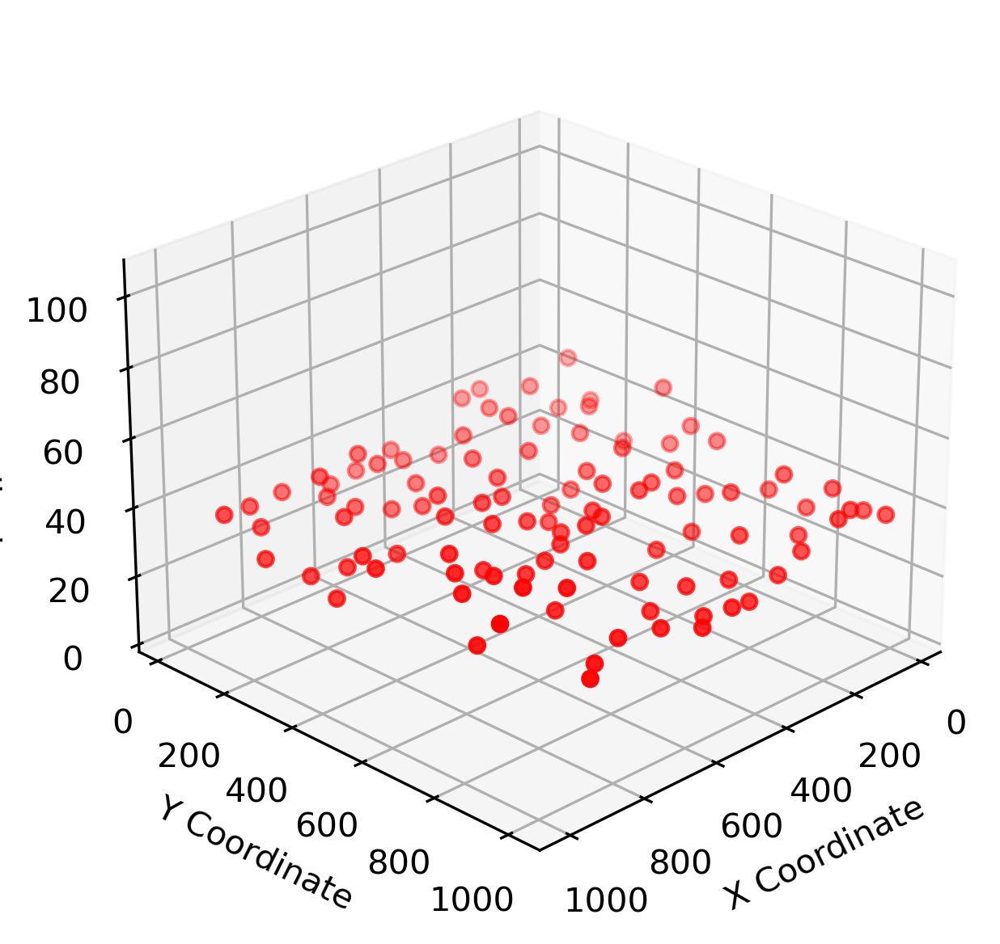

In [ ]:
def plot_centers_of_mass(centers_of_mass):
    """
    Plots the (x, y, z) coordinates of the centers of mass.

    :param centers_of_mass: List of tuples containing (x, y, z) coordinates of the centers of mass.
    """
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    xs = [coord[0] for coord in centers_of_mass]
    ys = [coord[1] for coord in centers_of_mass]
    zs = [coord[2] for coord in centers_of_mass]

    ax.scatter(xs, ys, zs, c='r', marker='o')

    ax.set_xlabel('X Coordinate')
    ax.set_ylabel('Y Coordinate')
    ax.set_zlabel('Z Coordinate')
    ax.set_zlim(0,108)
    ax.view_init(25, 45)

    plt.show()

# Example usage:
# Assuming 'image' is a 4D numpy array with shape (slices, channels, height, width)
# and 'masks' is a 3D numpy array with shape (slices, height, width)
plot_centers_of_mass(comp)

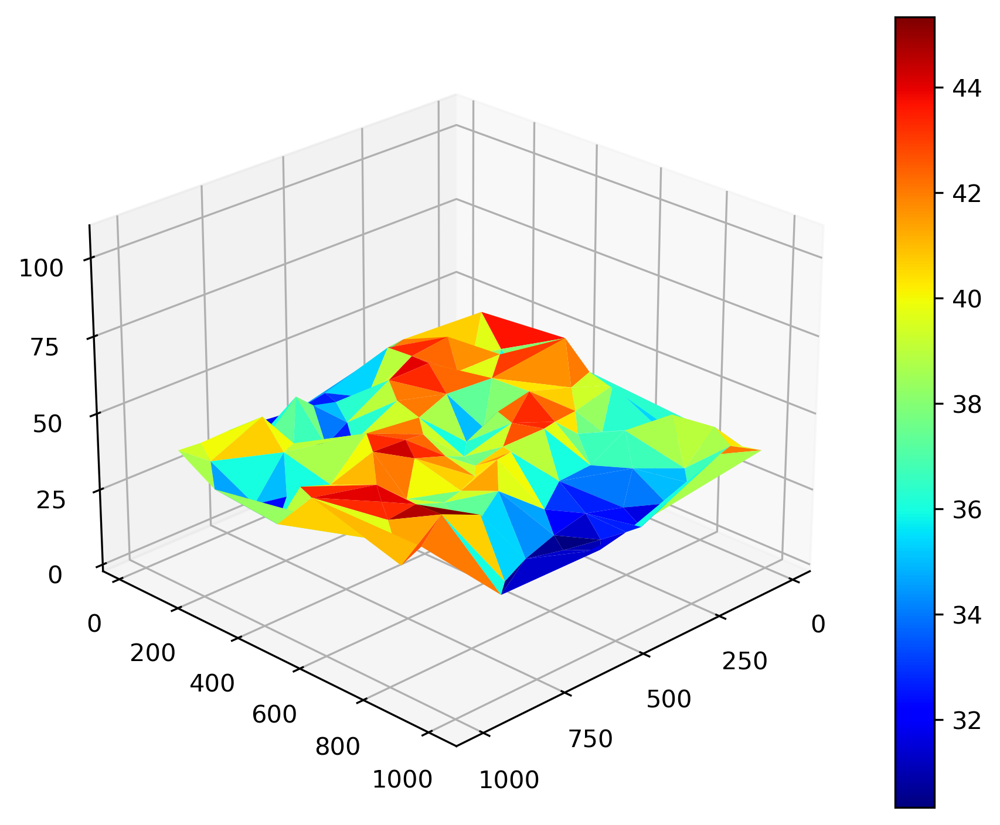

In [229]:
from matplotlib.ticker import MaxNLocator
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


xs = [coord[0] for coord in comp]
ys = [coord[1] for coord in comp]
zs = [coord[2] for coord in comp]

surf = ax.plot_trisurf(xs, ys, zs, cmap=cm.jet, linewidth=0)
fig.colorbar(surf)

ax.xaxis.set_major_locator(MaxNLocator(5))
ax.yaxis.set_major_locator(MaxNLocator(6))
ax.zaxis.set_major_locator(MaxNLocator(5))
ax.set_zlim(0,108)
ax.view_init(25, 45)

fig.tight_layout()

plt.show()

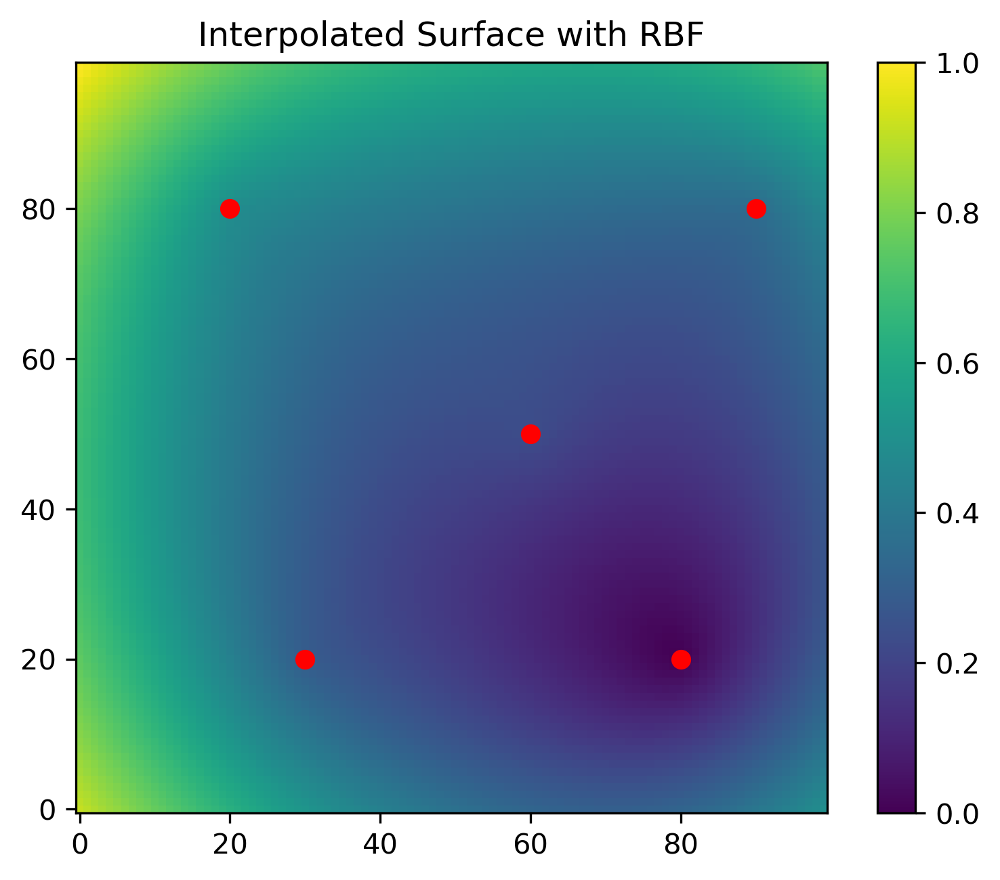

In [ ]:
import numpy as np
from scipy.interpolate import Rbf
import matplotlib.pyplot as plt

# Example 3D image array (substitute this with your actual data)
# Assume the shape of the array is (z, y, x)
image = np.random.rand(10, 100, 100)

# Assume we have markers at a particular layer (e.g., layer 5)
# Example markers at random positions (substitute with your actual markers)
markers_z = 5
markers_y = np.array([80, 20, 20, 50, 80])
markers_x = np.array([20, 80, 30, 60, 90])
markers_values = np.array([6.5, 4, 5.5, 5.2, 5.8])  # Height at these marker points

# Create a grid for interpolation
grid_x, grid_y = np.meshgrid(np.arange(image.shape[2]), np.arange(image.shape[1]))

# Use RBF for interpolation
rbf = Rbf(markers_x, markers_y, markers_values, function='linear')
flatten_surface = rbf(grid_x, grid_y)

# Plot the original markers and the interpolated surface
plt.figure()
plt.imshow(flatten_surface, origin='lower')
plt.scatter(markers_x, markers_y, c='red')
plt.title("Interpolated Surface with RBF")
plt.colorbar()
plt.show()

# Adjust the other layers relative to the new surface
flattened_image = np.zeros_like(image)

for z in range(image.shape[0]):
    for y in range(image.shape[1]):
        for x in range(image.shape[2]):
            new_z = int(z - (flatten_surface[y, x] - markers_z))
            if 0 <= new_z < image.shape[0]:
                flattened_image[z, y, x] = image[new_z, y, x]

# Now, flattened_image has the target layer flattened according to the markers


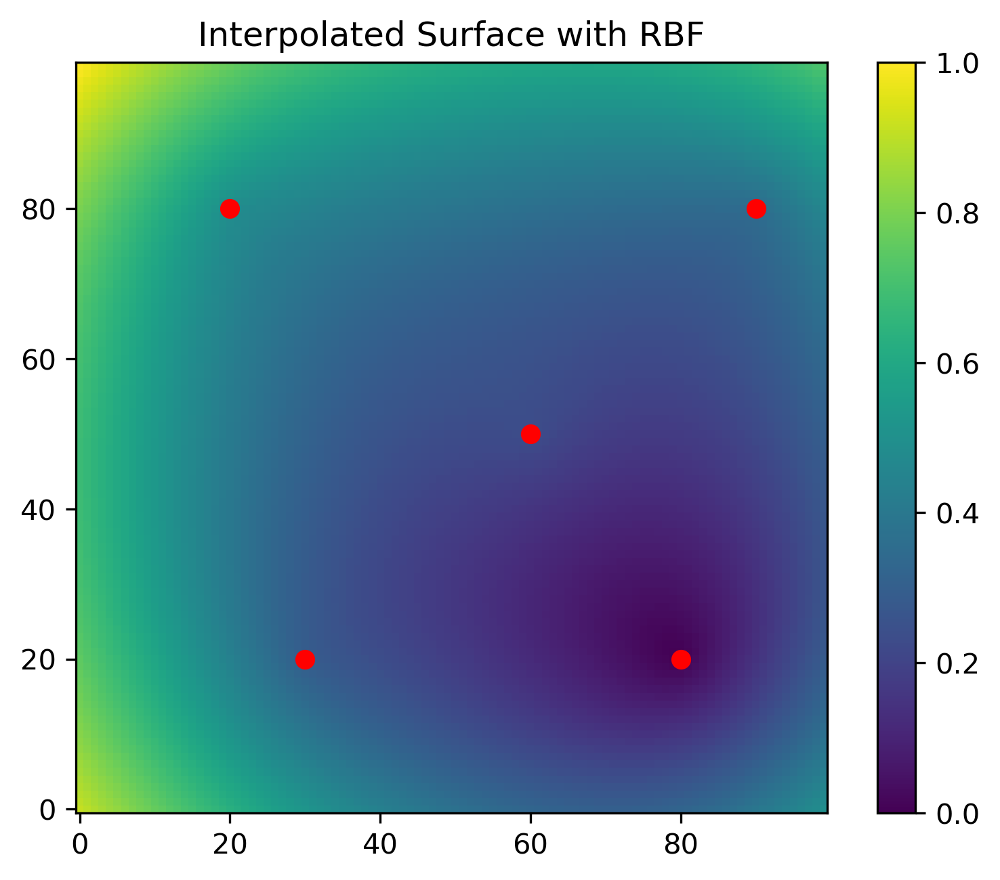

In [ ]:
import numpy as np
from scipy.interpolate import Rbf
import matplotlib.pyplot as plt

# Example 3D image array (substitute this with your actual data)
# Assume the shape of the array is (z, y, x)
image = np.random.rand(10, 100, 100)

# Assume we have markers at a particular layer (e.g., layer 5)
# Example markers at random positions (substitute with your actual markers)
markers_z = 5
markers_y = np.array([80, 20, 20, 50, 80])
markers_x = np.array([20, 80, 30, 60, 90])
markers_values = np.array([6.5, 4, 5.5, 5.2, 5.8])  # Height at these marker points

# Create a grid for interpolation
grid_x, grid_y = np.meshgrid(np.arange(image.shape[2]), np.arange(image.shape[1]))

# Use RBF for interpolation
rbf = Rbf(markers_x, markers_y, markers_values, function='linear')
flatten_surface = rbf(grid_x, grid_y)

# Plot the original markers and the interpolated surface
plt.figure()
plt.imshow(flatten_surface, origin='lower')
plt.scatter(markers_x, markers_y, c='red')
plt.title("Interpolated Surface with RBF")
plt.colorbar()
plt.show()

# Adjust the other layers relative to the new surface
flattened_image = np.zeros_like(image)

for z in range(image.shape[0]):
    for y in range(image.shape[1]):
        for x in range(image.shape[2]):
            new_z = int(z - (flatten_surface[y, x] - markers_z))
            if 0 <= new_z < image.shape[0]:
                flattened_image[z, y, x] = image[new_z, y, x]

# Now, flattened_image has the target layer flattened according to the markers


TypeError: Invalid shape (102, 4, 1024, 1024) for image data

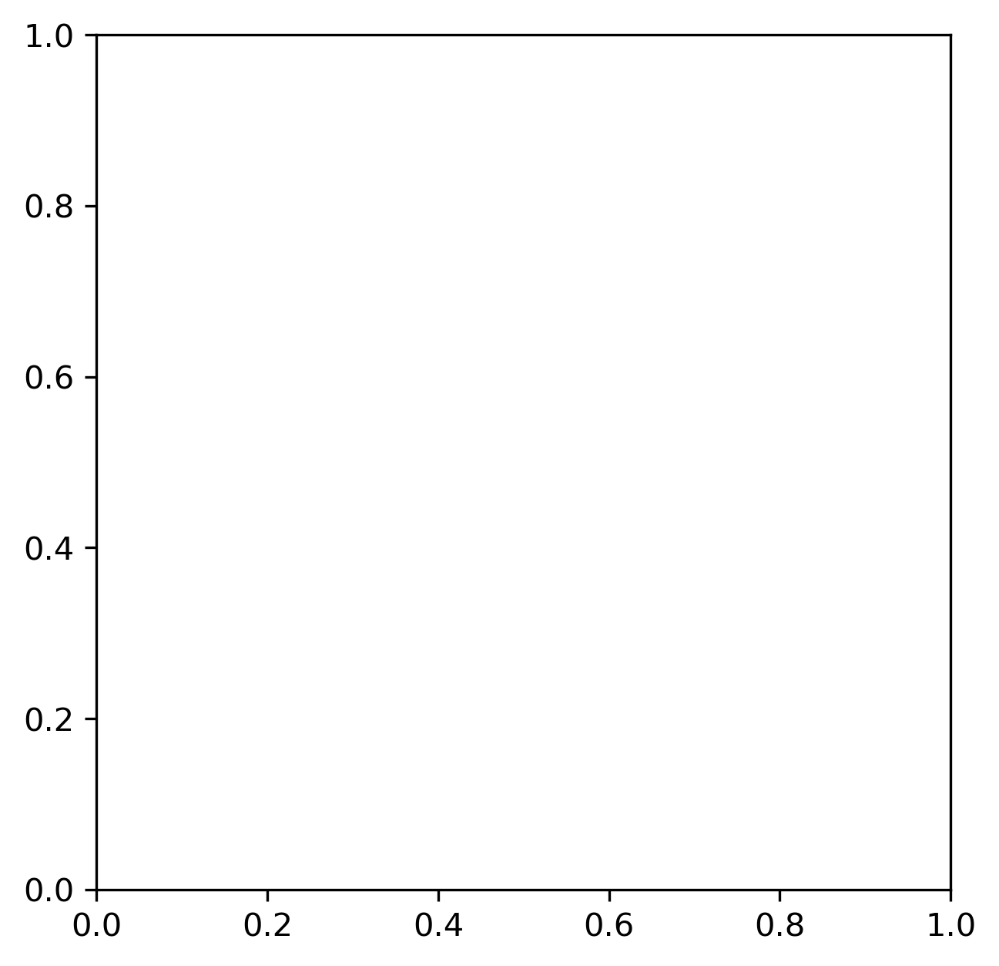

In [ ]:
plt.imshow(image)